# Regional Demand
This notebook contains the steps that have been taken to create the necessary files to be used for the suitability rasters as input for the regional demand for the Land use simulation model for the Roman period into land use for 1500.
De Kleijn, M., Beijaard, F., Koomen, E., Van Lanen, R., (2018) Simulating past land use: a modelling framework integrating natural and cultural factors, Journal of Archaeological Science Reports. http://dx.doi.org/10.1016/j.jasrep.2018.04.006 

In [1]:
import pandas as pd
import geopandas as gpd

In [2]:
# For the suitability for certain land use types the paleogeographical reconstruction publishedd by the Dutch Heritage agency was used. obtained from:
# https://www.cultureelerfgoed.nl/onderwerpen/bronnen-en-kaarten/documenten/publicaties/2019/01/01/paleogeografische-kaarten-zip

# These are vector files that need to converted to raster grids.

paleo_1500 = gpd.read_file("E:\Dropbox\PROJECTS\IISG_PLUS\Paloegeografie_1500\paleogeografie_1500.gpkg")

In [3]:
paleo_1500.explore()

In [4]:
paleo_1500.head()

,OBJECTID,legenda,omschrijving,SHAPE_Length,SHAPE_Area,geometry
0,1,beekdal,Riviervlakte en beekdalen,10673.451517,1.387010e+06,"MULTIPOLYGON (((186306.375 309628.000, 186349...."
1,2,beekdal,Riviervlakte en beekdalen,10498.923060,1.051800e+06,"MULTIPOLYGON (((184887.359 310435.969, 184910...."
2,3,beekdal,Riviervlakte en beekdalen,22734.722275,3.097513e+06,"MULTIPOLYGON (((180718.656 312744.125, 180687...."
3,4,beekdal,Riviervlakte en beekdalen,2056.527338,3.537364e+04,"MULTIPOLYGON (((176521.217 313505.233, 176521...."
4,5,beekdal,Riviervlakte en beekdalen,28006.751938,3.432104e+06,"MULTIPOLYGON (((179916.156 314164.812, 179967...."


In [5]:
pd.unique(paleo_1500['omschrijving'])

array(['Riviervlakte en beekdalen', 'Binnenwater', 'Buitenland',
       'Buitenwater', 'Pleistocene zandgebieden, beneden 16 en 0 m. -NAP',
       'Pleistocene zandgebieden, boven 0 m. NAP', 'Rivierduinen',
       'Strandwallen en lage duinen', 'Wadden en slikken',
       'Stuwwallen, gestuwde keileem en door stromend landijs gemodelleerde ruggen en dalen',
       'Hoge duinen', 'Bedijkte kwelders en riviervlakten',
       'Kwelders en riviervlakten',
       'Gebieden met kwelderwallen en -ruggen',
       'Strandvlakten en duinvalleien',
       'Pleistocene zandgebieden, beneden 16 m. -NAP', 'Lössgebied',
       'Gebieden met Tertiaire en oudere afzettingen', 'Stedelijk gebied',
       'Veengebied'], dtype=object)

In [6]:
pd.unique(paleo_1500['legenda'])

array(['beekdal', 'binnenwater', 'buitenland', 'buitenwater',
       'dekzand_hol', 'dekzand_pl', 'donk', 'duin', 'getijdenzone',
       'glaciaal', 'hoog duin', 'ingedijkt', 'kwelder', 'kwelderrug',
       'kwelderrug-binnendijks', 'laag duin', 'laag holoceen', 'loss',
       'ouder', 'stadcontour', 'strandwal', 'veen'], dtype=object)

In the PLUS model for the Roman period the following codes have been used for certain paleogeographical units:

	unit<uint8> Paleo_ID_22k: nrofrows = 23
	{
		attribute<Paleo_ID> Classes: DialogType = "Classification",
			[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22];

		attribute<UInt32> BrushColor: DialogType = "BrushColor",
			[rgb(179,179,179), 		//'none' 0
			rgb(9,9,145), 			//sea 1
			rgb(182,237,240), 		//residual 2
			rgb(31,131,224),    	//estuary 3
			rgb(34,89,199), 		//lake 4
			rgb(255,255,128),		//tidal 5
			rgb(245,238,54),		//new dune 6
			rgb(65,128,79),		//high levee 7
			rgb(100,156,113),		//moderate levee 8
			rgb(136,184,149),		//low levee 9
			rgb(240,226,192),		//river dunes 10	
			rgb(133,39,8),			//fluvial terrace 11
			rgb(107,6,1),			//covered alluvial ridge 12
			rgb(178,214,190),		//high floodplain 13
			rgb(220,245,233),		//low floodplain 14
			rgb(201,250,55),		//eutrophic peat 15
			rgb(221,232,179),		//mesotrophic peat 16
			rgb(75,58,70),			//oligotrophic peat 17 
			rgb(34,102,51),		//high pleistocene sands 18
			rgb(191,161,69),		//cover sand 19
			rgb(130,130,130),		//post roman erosion 20
			rgb(85,15,247),	    //Barrierplain 21
			rgb(100,238,54)		//old dune 22
			];

		attribute<String> Label: DialogType = "LabelText",
			[
			'none', 'sea', 'residual gully', 'estuary', 'lake', 													// water bodies
			'tidal flats', 'new dune', 'high levee', 'moderate levee', 'low levee', 'river dunes', 					// dry lands
			'fluvial terrace', 'covered alluvial ridge', 'high floodplain', 'low floodplain', 						// flood basins
			'eutrophic peat', 'mesotrophic peat', 'oligotrophic peat', 												// peat areas
			'high pleistocene sands', 'cover sand', 																// sandy areas
			'post roman erosion', 'Barrierplain','old dune'																	// rest
			];	

In [7]:
# A matching took place based done by Maurice with limited knowledge on paleography. An expert need to have a look at it at a later stage.
paleo_1500['paleo_code'] = paleo_1500['omschrijving'].replace({   
    'Riviervlakte en beekdalen': 14, # rgb(220,245,233) – low floodplain (14) | Low-lying river/brook valleys
    'Binnenwater': 4, # rgb(34,89,199) – lake (4) | Lakes and other inland water bodies
    'Buitenland': 0, # rgb(179,179,179) – none (0) | Outside the mapped area
    'Buitenwater': 1, #  rgb(9,9,145) – sea (1) | Sea or coastal water
    'Pleistocene zandgebieden, beneden 16 en 0 m. -NAP': 19, # rgb(191,161,69) – cover sand (19) | Cover sands in low areas
    'Pleistocene zandgebieden, boven 0 m. NAP': 18, # rgb(34,102,51) – high Pleistocene sands (18) | Elevated Pleistocene sands
    'Rivierduinen' : 10, #  rgb(240,226,192) – river dunes (10)
    'Strandwallen en lage duinen': 22, #rgb(100,238,54) – old dune (22) | Coastal dune formations
    'Wadden en slikken': 3,  #rgb(31,131,224) – estuary (3) | Tidal/muddy estuarine zone
    'Stuwwallen, gestuwde keileem en door stromend landijs gemodelleerde ruggen en dalen': 11, # rgb(133,39,8) – fluvial terrace (11) | Possibly best match for elevated/glacially shaped area
    'Hoge duinen': 6, #rgb(245,238,54) – new dune (6) | Recently formed or tall dunes
    'Bedijkte kwelders en riviervlakten': 13, #rgb(178,214,190) – high floodplain (13) | Managed floodplain areas
    'Kwelders en riviervlakten': 14, #rgb(220,245,233) – low floodplain (14) | Undiked lower floodplains
    'Gebieden met kwelderwallen en -ruggen': 9, #rgb(136,184,149) – low levee (9) | Shaped marshy levee zones
    'Strandvlakten en duinvalleien': 21, #rgb(85,15,247) – barrierplain (21) | Coastal plains/transition zones
    'Pleistocene zandgebieden, beneden 16 m. -NAP': 19, #rgb(191,161,69) – cover sand (19) | Similar to previous sand areas
    'Lössgebied': 11, #rgb(133,39,8) – fluvial terrace (11) | Loess often forms elevated terraces
    'Gebieden met Tertiaire en oudere afzettingen': 20, #rgb(130,130,130) – post roman erosion (20) | Deep-time sediment/erosion areas
    'Stedelijk gebied': 0, #rgb(179,179,179) – none (0) | Often excluded or unclassified
    'Veengebied': 16 #rgb(75,58,70) – eutrophic, mesotrophic, oligotrophic peat (15–17) | Multiple peat types depending on nutrient level
})

C:\Users\Maurice de Kleijn\AppData\Local\Temp\ipykernel_19232\1033578165.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  paleo_1500['paleo_code'] = paleo_1500['omschrijving'].replace({


In [ ]:
#loading the original input in order to get it fully alligned with the paleo 1500 data

In [8]:
import rioxarray
paleo_100 = rioxarray.open_rasterio("E:\Dropbox\PROJECTS\IISG_PLUS\PLUS_1500\Model_Configuration\LUS\LUS_AD140_100m\data\Start_situation\Thematic_maps\Paleogeography\paleo_ID_ad100.tif")


In [9]:
print(paleo_100)

<xarray.DataArray (band: 1, y: 3250, x: 2700)> Size: 9MB
[8775000 values with dtype=int8]
Coordinates:
  * band         (band) int32 4B 1
  * x            (x) float64 22kB 1.005e+04 1.015e+04 ... 2.798e+05 2.8e+05
  * y            (y) float64 26kB 6.25e+05 6.248e+05 ... 3.002e+05 3e+05
    spatial_ref  int32 4B 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0
    long_name:      rasterized


In [10]:
print(paleo_100.rio.crs)
print(paleo_100.rio.nodata)
print(paleo_100.rio.bounds())
print(paleo_100.rio.width)
print(paleo_100.rio.height)
print(paleo_100.rio.resolution())


PROJCS["Bessel_1841_Stereographic",GEOGCS["Unknown datum based upon the Bessel 1841 ellipsoid",DATUM["unknown",SPHEROID["Bessel 1841",6377397.155,299.1528128]],PRIMEM["Greenwich",0],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]]],PROJECTION["Stereographic"],PARAMETER["latitude_of_origin",52.156160556],PARAMETER["central_meridian",5.387638889],PARAMETER["scale_factor",0.9999079],PARAMETER["false_easting",155000],PARAMETER["false_northing",463000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]
None
(10000.0, 300000.0, 280000.0, 625000.0)
2700
3250
(100.0, -100.0)


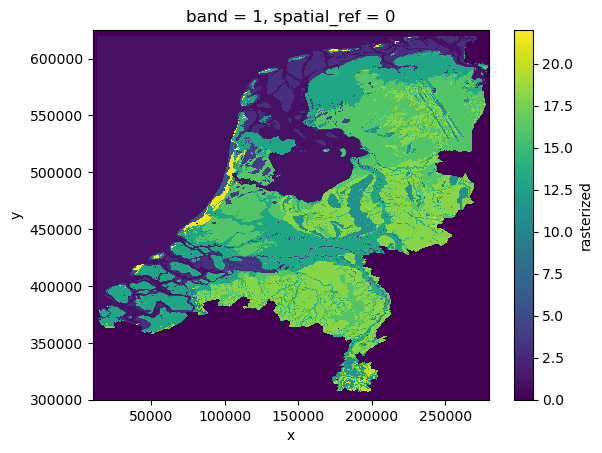

In [11]:
paleo_100.plot()

In [12]:
# convert vector paleogeography into raster with the same dimensions a the Roman PLUS
import geopandas as gpd
import rioxarray
import rasterio
from rasterio.features import rasterize
import xarray as xr
import numpy as np

# --- Load your raster (already done, but included here for clarity) ---
# paleo_100 = rioxarray.open_rasterio("path/to/paleo_100.tif")

# --- Step 1: Get raster metadata from paleo_100 ---
transform = paleo_100.rio.transform()
out_shape = paleo_100.rio.shape
crs = paleo_100.rio.crs

# --- Step 2: Reproject vector to match raster CRS ---
paleo_1500 = paleo_1500.to_crs(crs)

# --- Step 3: Prepare geometries with values from 'paleo_code' ---
geoms = [
    (geom, value)
    for geom, value in zip(paleo_1500.geometry, paleo_1500["paleo_code"])
    if geom is not None and not np.isnan(value)
]

# --- Step 4: Rasterize the geometries ---
rasterized = rasterize(
    geoms,
    out_shape=out_shape,
    transform=transform,
    fill=0,              # background value
    dtype="int8"        # or "float32" if needed
)

# --- Step 5: Wrap in an xarray DataArray (2D version) ---
rasterized_xr = xr.DataArray(
    rasterized,
    coords={"y": paleo_100.y, "x": paleo_100.x},
    dims=("y", "x"),
    name="rasterized"
)
rasterized_xr.rio.write_crs(crs, inplace=True)

# --- Step 6: Save to file ---
rasterized_xr.rio.to_raster("paleo_1500_rasterized.tif")

print("✅ Rasterization complete. Output saved as 'paleo_1500_rasterized.tif'")


✅ Rasterization complete. Output saved as 'paleo_1500_rasterized.tif'


In [ ]:
#the file produced above is used as input for the suitability score that have been added and can be modified in thematic_maps.dms


In [ ]:
# The data folder of the PLUS model also contains a start situation, which is needed to be filled especially with exogenous land use type that are not effected by the allocation process. 
# Water, and settlements (residential lu_lnr1 ) also this allows to exclude certain areas outside the study area.

In [16]:
residential = gpd.read_file("settlement_core.gpkg")

<Axes: >

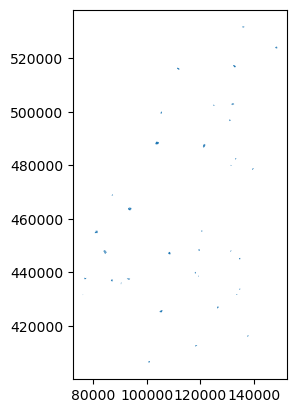

In [17]:
residential.plot()

In [18]:
empty_asci = rioxarray.open_rasterio("X:\Repos_github\PLUS_1500\lu_lnrx.asc")

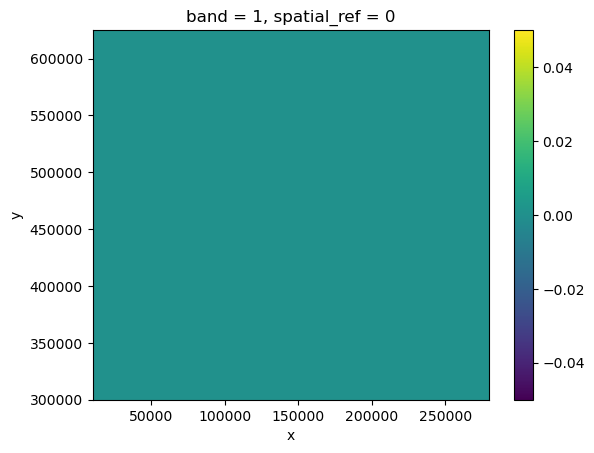

In [19]:
empty_asci.plot()

In [ ]:
# Open the reference raster with rioxarray
ref_band = empty_asci.sel(band=1)  # we need band 1

# Get transform and shape from the reference raster
transform = ref_band.rio.transform()
out_shape = ref_band.shape

# Rasterize the polygons onto the same grid
binary_data = rasterize(
    [(geom, 1) for geom in residential.geometry],
    out_shape=out_shape,
    transform=transform,
    fill=0,
    dtype="uint8"
)

# Create a DataArray from the rasterized array
binary_raster = xr.DataArray(
    binary_data[np.newaxis, :, :],  # Add a 'band' dimension
    coords={
        "band": [1],
        "y": ref_band.y,
        "x": ref_band.x
    },
    dims=("band", "y", "x")
)

# Save the raster to asc 
binary_raster.rio.to_raster("binary_output.asc") #this is lu_lnr1.asc for the start land_use

The output asci generated this as heading 

ncols        2700
nrows        3250
xllcorner    10000.000000000000
yllcorner    300000.000000000000
cellsize     100.000000000000

whereas the PLUS needs: 

ncols         2700
nrows         3250
xllcorner     10000
yllcorner     300000
cellsize      100
NODATA_value  -9999

ftm I manually updated this.

In [15]:
study_area = gpd.read_file("study_area.gpkg")

In [ ]:
# We now do the same for the study_area 
ref_band = empty_asci.sel(band=1)  # we need band 1

# Get transform and shape from the reference raster
transform = ref_band.rio.transform()
out_shape = ref_band.shape

# Rasterize the polygons onto the same grid
binary_data = rasterize(
    [(geom, 0) for geom in study_area.geometry], #the exterior requires to be 1 for the exterior parts, therefore we invert it here
    out_shape=out_shape,
    transform=transform,
    fill=1, #the exterior requires to be 1 for the exterior parts, therefore we invert it here
    dtype="uint8"
)

# Create a DataArray from the rasterized array
binary_raster = xr.DataArray(
    binary_data[np.newaxis, :, :],  # Add a 'band' dimension
    coords={
        "band": [1],
        "y": ref_band.y,
        "x": ref_band.x
    },
    dims=("band", "y", "x")
)

# Save the raster to asc 
binary_raster.rio.to_raster("lu_lnr9.asc") #same issue with heading manually adjusted

In [ ]:
#Finally we create lu_lnr8 which is the water. for this we selected the water from the paleo_1500 geopackage


In [25]:
paleo_1500['water'] = paleo_1500['omschrijving'].replace({   
    'Riviervlakte en beekdalen': 0,
    'Binnenwater': 1,
    'Buitenland': 0,
    'Buitenwater': 1,
    'Pleistocene zandgebieden, beneden 16 en 0 m. -NAP': 0, 
    'Pleistocene zandgebieden, boven 0 m. NAP': 0,
    'Rivierduinen' : 0, 
    'Strandwallen en lage duinen': 0,
    'Wadden en slikken': 1, 
    'Stuwwallen, gestuwde keileem en door stromend landijs gemodelleerde ruggen en dalen': 0,
    'Hoge duinen': 0, 
    'Bedijkte kwelders en riviervlakten': 0,
    'Kwelders en riviervlakten': 0, 
    'Gebieden met kwelderwallen en -ruggen': 0,
    'Strandvlakten en duinvalleien': 0, 
    'Pleistocene zandgebieden, beneden 16 m. -NAP': 0,
    'Lössgebied': 0, 
    'Gebieden met Tertiaire en oudere afzettingen': 0,
    'Stedelijk gebied': 0, 
    'Veengebied': 0 
})

C:\Users\Maurice de Kleijn\AppData\Local\Temp\ipykernel_19232\2232993620.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  paleo_1500['water'] = paleo_1500['omschrijving'].replace({


In [26]:
water = paleo_1500[paleo_1500['water'] == 1].copy()

In [28]:
water.explore()

In [30]:
# We now do the same for the study_area, yes I know it might be better to create a function here...
ref_band = empty_asci.sel(band=1)  # we need band 1

# Get transform and shape from the reference raster
transform = ref_band.rio.transform()
out_shape = ref_band.shape

# Rasterize the polygons onto the same grid
binary_data = rasterize(
    [(geom, 1) for geom in water.geometry],
    out_shape=out_shape,
    transform=transform,
    fill=0,
    dtype="uint8"
)

# Create a DataArray from the rasterized array
binary_raster = xr.DataArray(
    binary_data[np.newaxis, :, :],  # Add a 'band' dimension
    coords={
        "band": [1],
        "y": ref_band.y,
        "x": ref_band.x
    },
    dims=("band", "y", "x")
)

# Save the raster to asc 
binary_raster.rio.to_raster("lu_lnr8.asc") #same issue with heading manually adjusted

In [31]:
from scipy.ndimage import distance_transform_edt

In [33]:
from scipy.ndimage import distance_transform_edt

# Load the binary raster
with rasterio.open("binary_output.asc") as src:
    binary = src.read(1)
    transform = src.transform
    nodata = src.nodata

# Define sources: e.g. where value == 1
sources = (binary == 1)

# Cost distance: distance from 0s to 1s (inverse logic)
distance = distance_transform_edt(~sources) * transform.a  # adjust by cellsize

# Optional: save result
with rasterio.open("cost_distance.tif", "w", **src.meta) as dst:
    dst.write(distance.astype(np.float32), 1)

In [36]:
cost_dist = rioxarray.open_rasterio("cost_distance.tif")
cost_dist.rio.to_raster("cost_dist.asc") #same issue with heading manually adjusted